<a href="https://colab.research.google.com/github/aaditya620321/Face-Mask-Detection/blob/main/opencv.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D , MaxPooling2D,Dropout ,Flatten ,Dense
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np
import matplotlib.pyplot as plt



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
main_dir = ("/content/drive/My Drive/New Masks Dataset")
train_dir = os.path.join(main_dir,'Train')
test_dir = os.path.join(main_dir,'Test')
valid_dir = os.path.join(main_dir,'Validation')

train_mask_dir = os.path.join(train_dir,'Mask')
train_nomask_dir = os.path.join(train_dir,'Non Mask')

In [ ]:
print(train_mask_dir)

/content/drive/My Drive/New Masks Dataset/Train/Mask


In [ ]:
train_mask_names =os.listdir(train_mask_dir)
print(train_mask_names[:10])
train_nomask_names =os.listdir(train_nomask_dir)
print(train_nomask_names[:10])

['0019.jpg', '0027.jpg', '0037.jpg', '0018.jpg', '0003.jpg', '0042.jpg', '0040.jpg', '0022.jpg', '0006.jpg', '0029.jpg']
['145.jpg', '104.jpg', '157.jpg', '117.jpg', '1.jpg', '143.jpg', '136.jpg', '119.jpg', '100.jpg', '146.jpg']


In [ ]:
train_datagen =ImageDataGenerator(rescale =1./255,
                                  zoom_range =0.2,
                                  rotation_range= 40,
                                  horizontal_flip= True)

test_datagen =ImageDataGenerator(rescale =1./255)
valid_datagen =ImageDataGenerator(rescale =1./255)

train_generator =train_datagen.flow_from_directory(train_dir,
                                  target_size=(150,150),
                                  batch_size =32,
                                  class_mode ='binary'
                                  )
test_generator=test_datagen.flow_from_directory(test_dir,
                                  target_size=(150,150),
                                  batch_size =32,
                                  class_mode ='binary'
                                  )
valid_generator=valid_datagen.flow_from_directory(valid_dir,
                                  target_size=(150,150),
                                  batch_size =32,
                                  class_mode ='binary'
                                  )



Found 610 images belonging to 2 classes.
Found 100 images belonging to 2 classes.
Found 315 images belonging to 2 classes.


In [ ]:
train_generator.class_indices

{'Mask': 0, 'Non Mask': 1}

In [ ]:
train_generator.image_shape

(150, 150, 3)

In [ ]:
model=Sequential()
model.add(Conv2D(32,(3,3),padding ='SAME',activation='relu',input_shape= (150,150,3)))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.5))

model.add(Conv2D(64,(3,3),padding ='SAME',activation ='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.5))

model.add(Flatten())

model.add(Dense(256,activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(1,activation ='sigmoid'))
model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 150, 150, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 75, 75, 32)       0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 75, 75, 32)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 75, 75, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 37, 37, 64)       0         
 2D)                                                             
                                                                 
 dropout_1 (Dropout)         (None, 37, 37, 64)        0

In [ ]:
model.compile(Adam(lr=0.001),loss ='binary_crossentropy',metrics=['accuracy'])

In [ ]:
history =model.fit(train_generator,
                   epochs =10,
                   validation_data= valid_generator)

Epoch 1/10
20/20 [==============================] - 264s 13s/step - loss: 3.4968 - accuracy: 0.5393 - val_loss: 0.6931 - val_accuracy: 0.5302
Epoch 2/10
20/20 [==============================] - 54s 3s/step - loss: 0.6874 - accuracy: 0.5049 - val_loss: 0.6928 - val_accuracy: 0.5048
Epoch 3/10
20/20 [==============================] - 55s 3s/step - loss: 0.6499 - accuracy: 0.5525 - val_loss: 0.6159 - val_accuracy: 0.6000
Epoch 4/10
20/20 [==============================] - 72s 4s/step - loss: 0.5674 - accuracy: 0.7475 - val_loss: 0.5774 - val_accuracy: 0.7365
Epoch 5/10
20/20 [==============================] - 66s 3s/step - loss: 0.4319 - accuracy: 0.8262 - val_loss: 0.5372 - val_accuracy: 0.7111
Epoch 6/10
20/20 [==============================] - 65s 3s/step - loss: 0.3479 - accuracy: 0.8754 - val_loss: 0.4499 - val_accuracy: 0.8095
Epoch 7/10
20/20 [==============================] - 65s 3s/step - loss: 0.2856 - accuracy: 0.9000 - val_loss: 0.4270 - val_accuracy: 0.7905
Epoch 8/10
20/20 [

In [ ]:
test_loss,test_acc =model.evaluate(test_generator)
print('test_acc:{}test loss:{}'.format(test_acc,test_loss))

4/4 [==============================] - 23s 7s/step - loss: 0.3146 - accuracy: 0.8800
test_acc:0.8799999952316284test loss:0.3146148920059204


In [ ]:
model.save('/newsaved_model.h5')


In [ ]:
import numpy as np
import tensorflow as tf
from google.colab import files
from keras.preprocessing import image

uploaded =files.upload()
#print(uploaded)
for f in uploaded.keys():
  img_path ='/content/'+f
  img=tf.keras.utils.load_img(img_path,target_size =(150,150))
  images =tf.keras.utils.img_to_array(img)
  images=np.expand_dims(images,axis =0)
  prediction =model.predict(images)
  if prediction==0:
    print(f,'Mask is present')
  else:
    print(f,'mask is not present')

TypeError: ignored

True
1/1 [==============================] - 0s 67ms/step


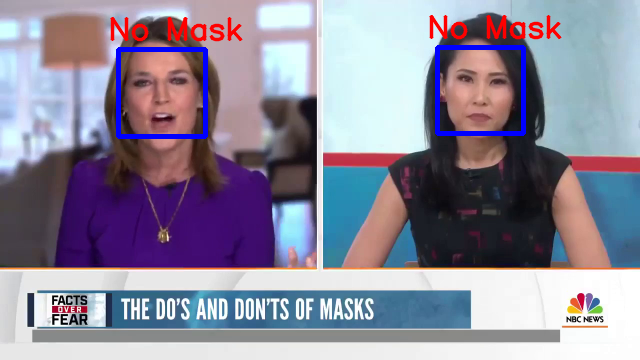

1/1 [==============================] - 0s 64ms/step


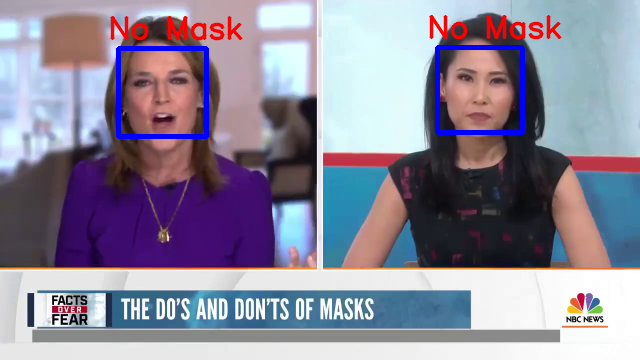

1/1 [==============================] - 0s 62ms/step


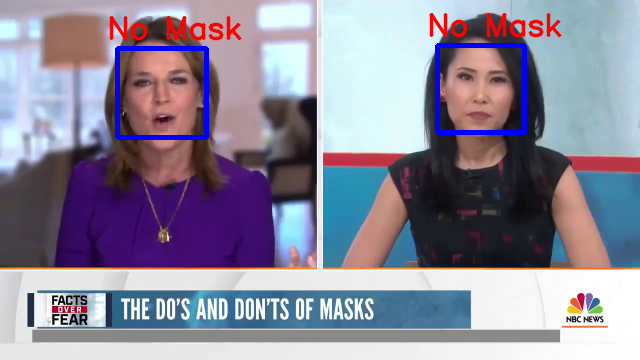

1/1 [==============================] - 0s 64ms/step


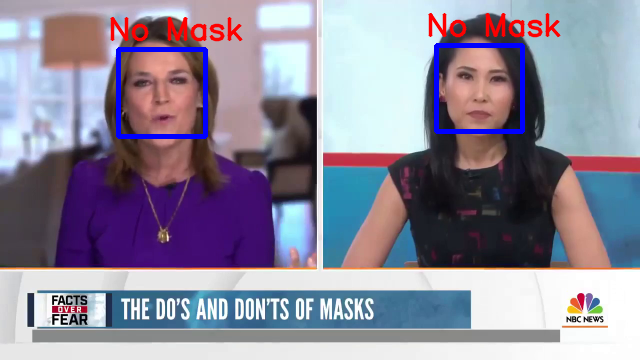

1/1 [==============================] - 0s 64ms/step


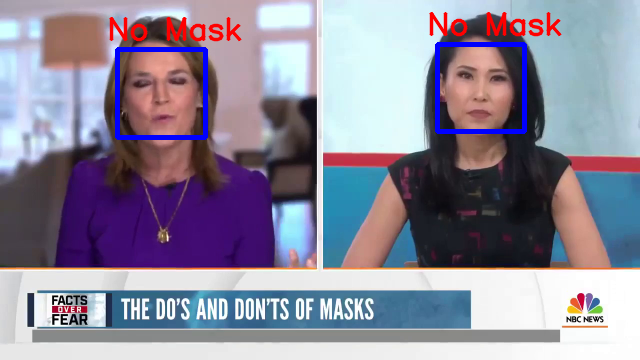

1/1 [==============================] - 0s 93ms/step


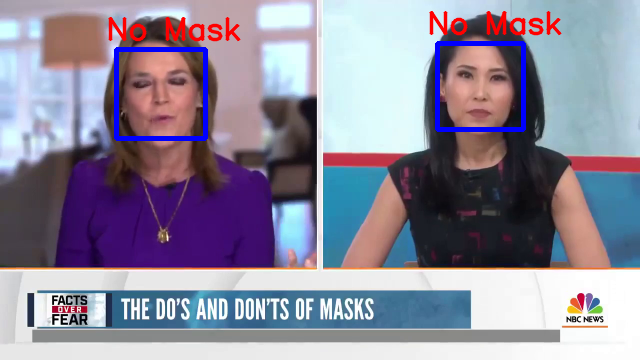

1/1 [==============================] - 0s 70ms/step


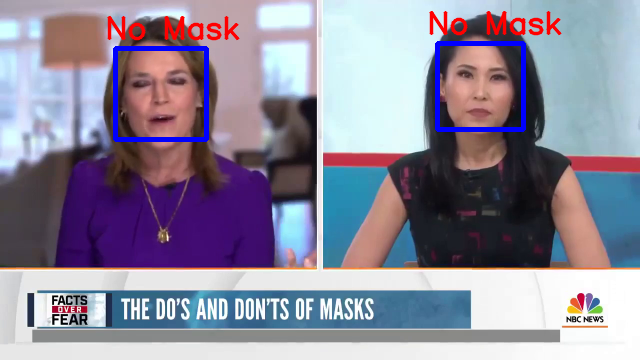

1/1 [==============================] - 0s 47ms/step


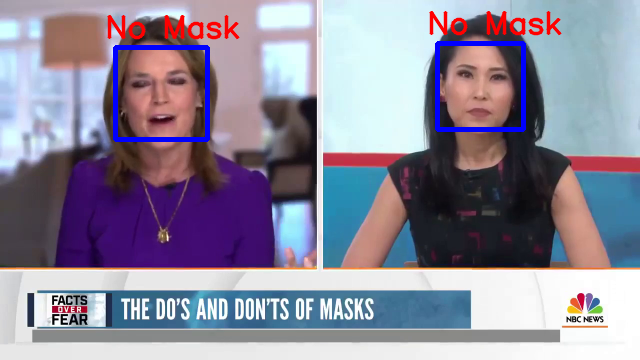

1/1 [==============================] - 0s 47ms/step


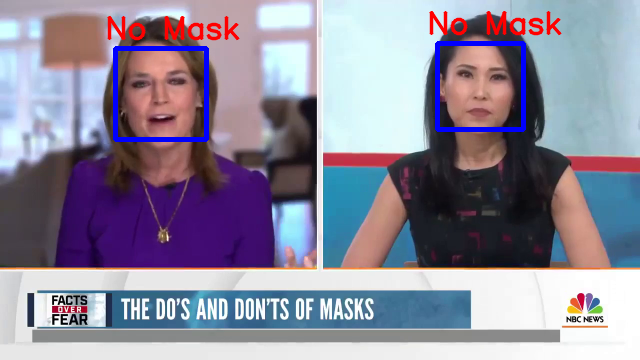

1/1 [==============================] - 0s 46ms/step


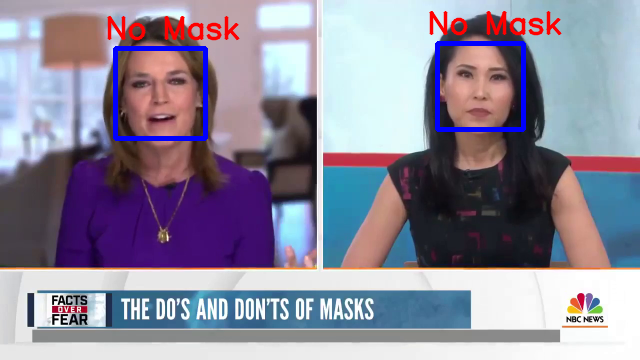

1/1 [==============================] - 0s 69ms/step


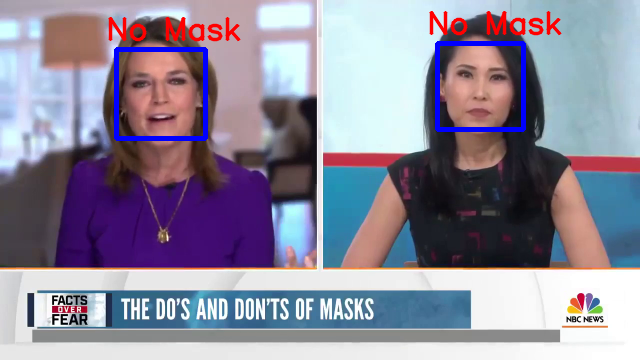

1/1 [==============================] - 0s 46ms/step


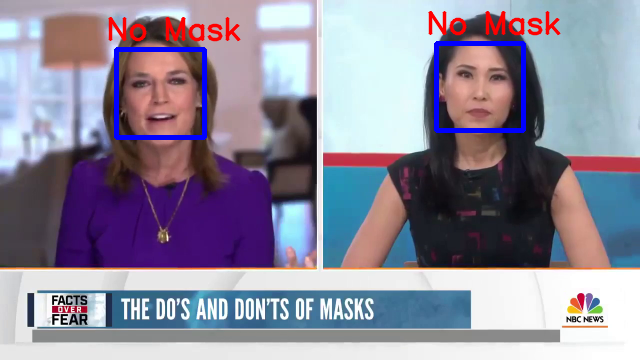

1/1 [==============================] - 0s 51ms/step


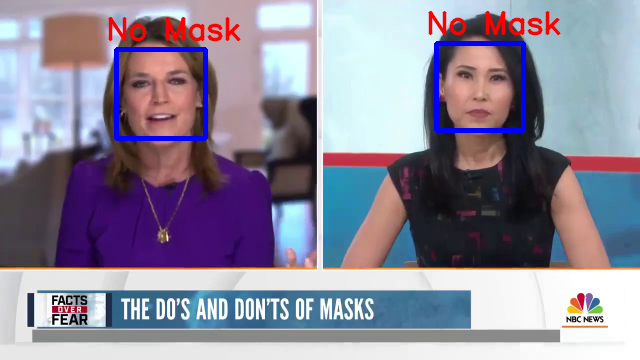

1/1 [==============================] - 0s 55ms/step


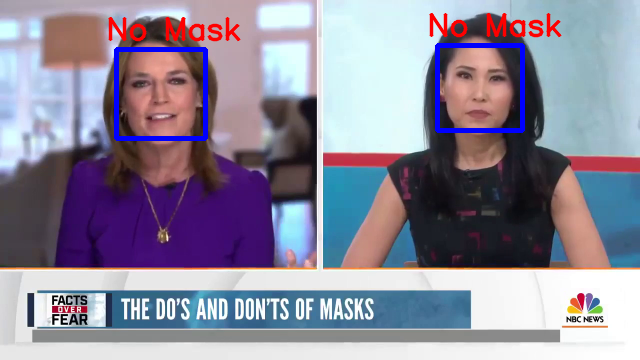

1/1 [==============================] - 0s 53ms/step


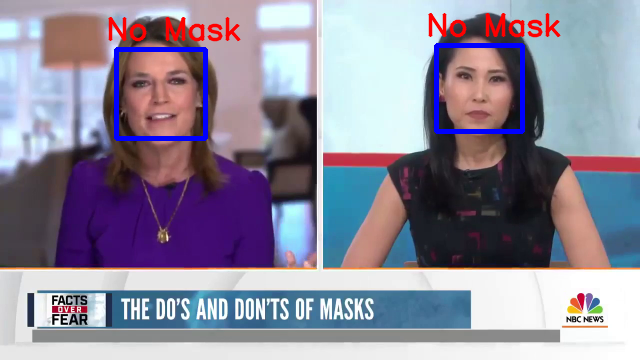

1/1 [==============================] - 0s 44ms/step


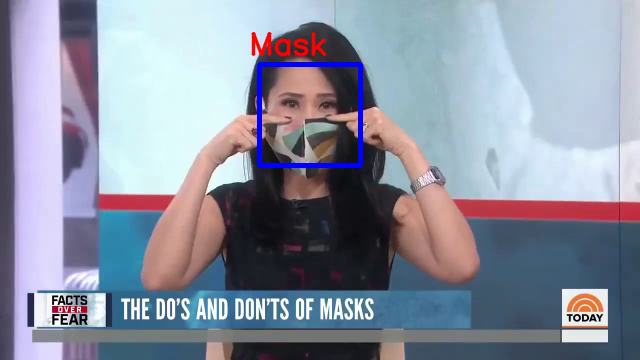

1/1 [==============================] - 0s 43ms/step


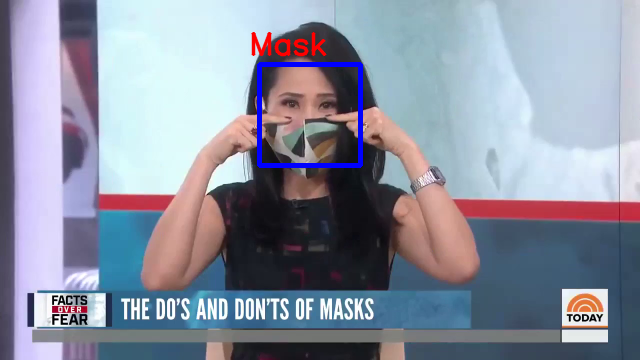

1/1 [==============================] - 0s 53ms/step


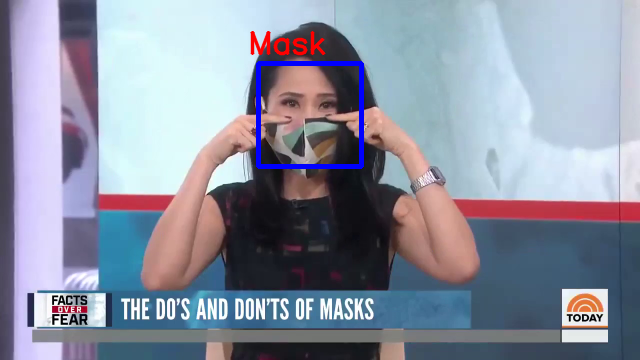

1/1 [==============================] - 0s 45ms/step


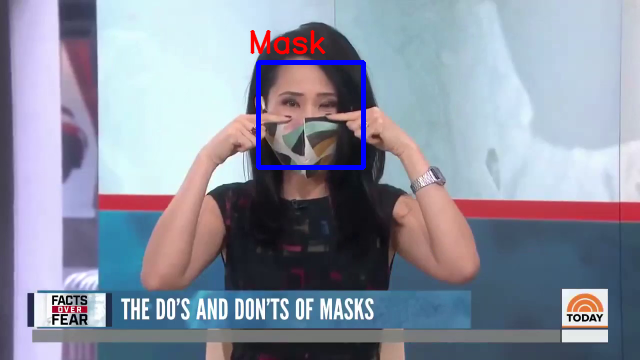

1/1 [==============================] - 0s 44ms/step


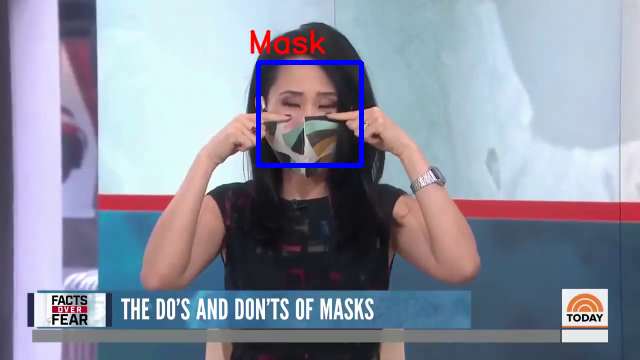

1/1 [==============================] - 0s 42ms/step


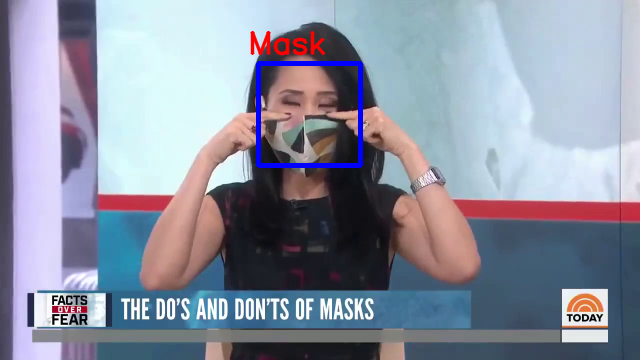

1/1 [==============================] - 0s 43ms/step


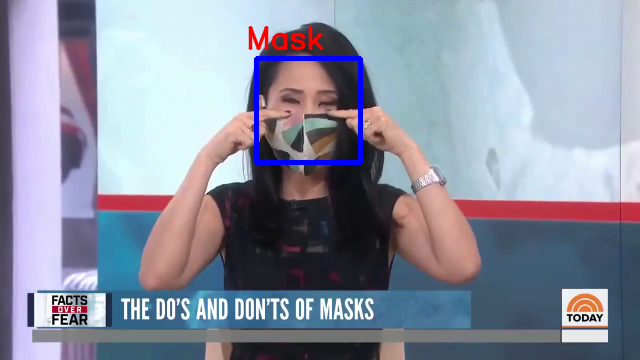

1/1 [==============================] - 0s 43ms/step


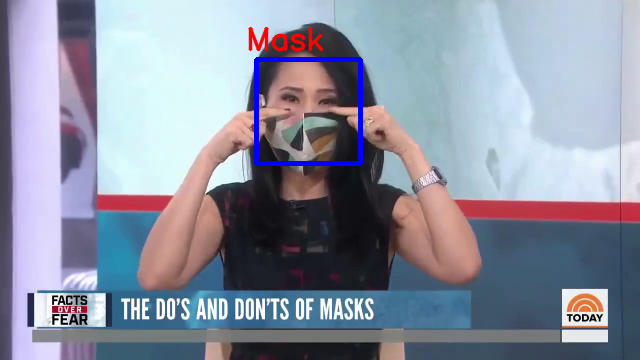

1/1 [==============================] - 0s 52ms/step


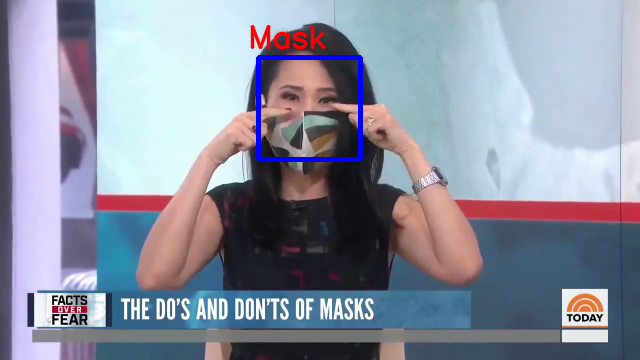

1/1 [==============================] - 0s 47ms/step


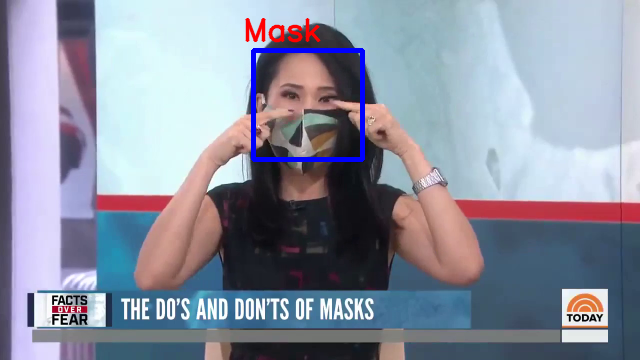

1/1 [==============================] - 0s 43ms/step


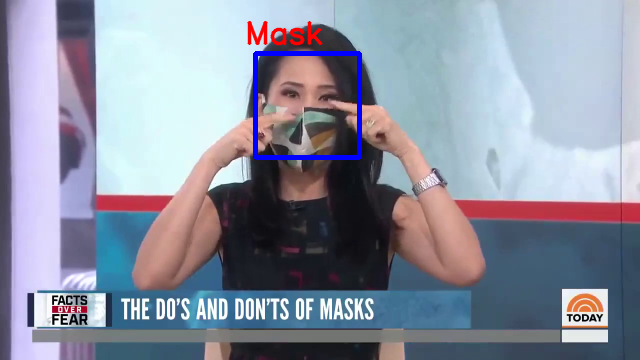

1/1 [==============================] - 0s 67ms/step


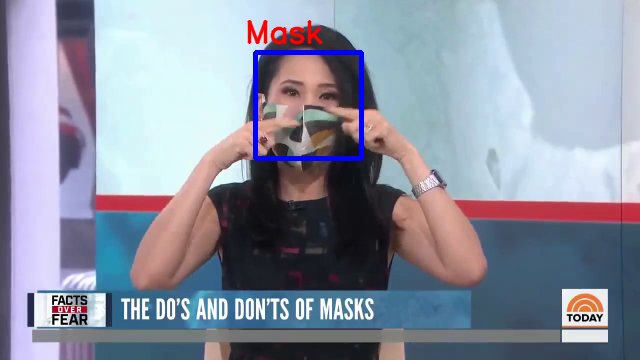

1/1 [==============================] - 0s 49ms/step


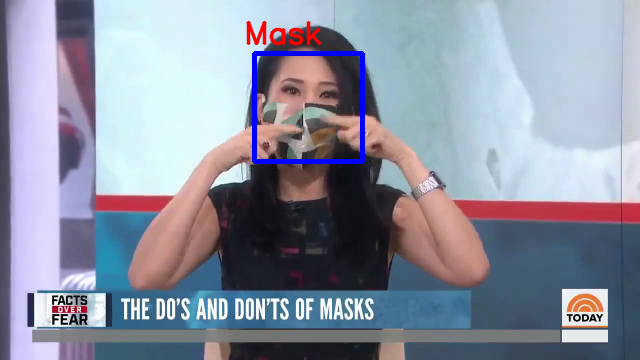

1/1 [==============================] - 0s 44ms/step


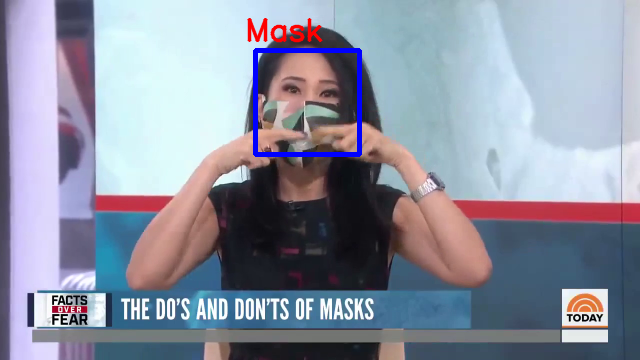

1/1 [==============================] - 0s 54ms/step


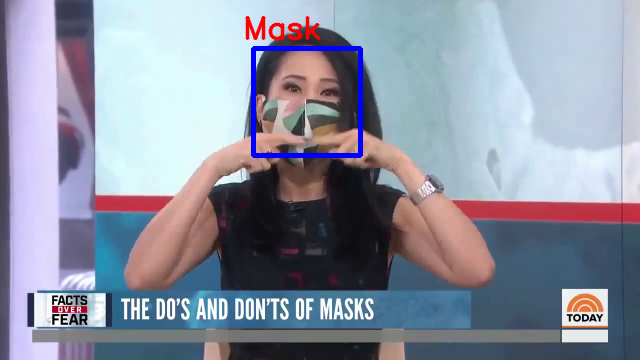

1/1 [==============================] - 0s 69ms/step


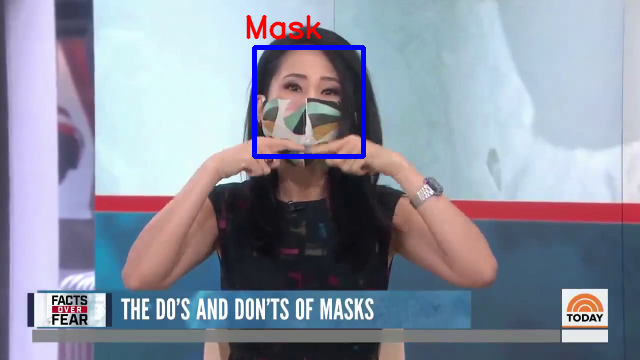

1/1 [==============================] - 0s 76ms/step


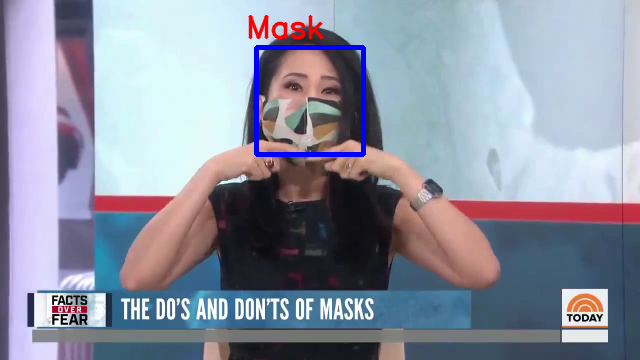

1/1 [==============================] - 0s 91ms/step


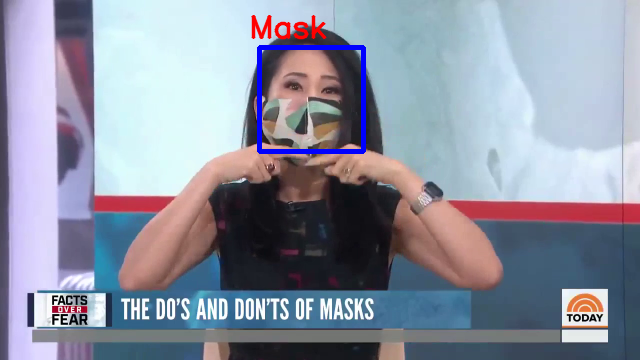

1/1 [==============================] - 0s 75ms/step


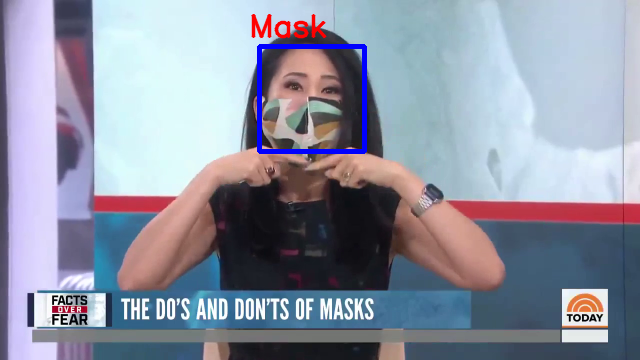

1/1 [==============================] - 0s 80ms/step


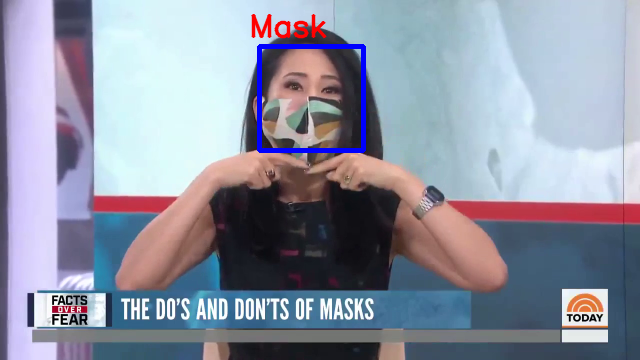

1/1 [==============================] - 0s 89ms/step


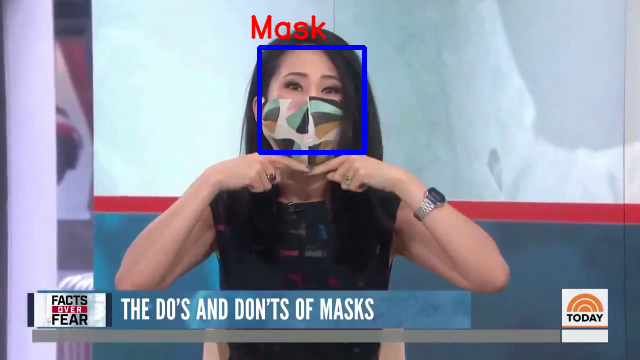

1/1 [==============================] - 0s 92ms/step


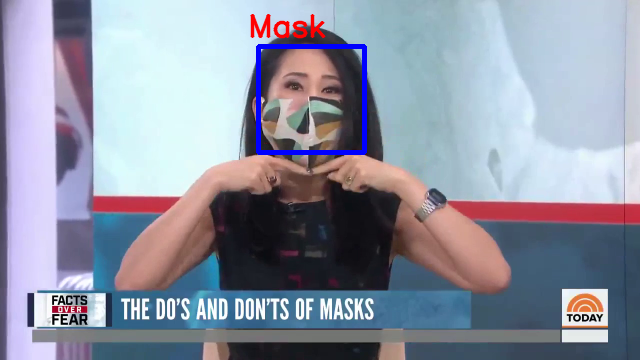

1/1 [==============================] - 0s 103ms/step


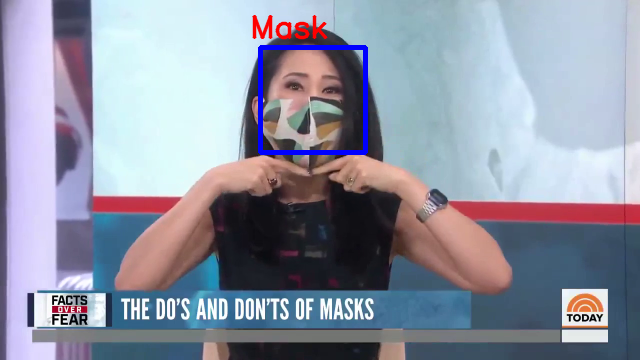

1/1 [==============================] - 0s 101ms/step


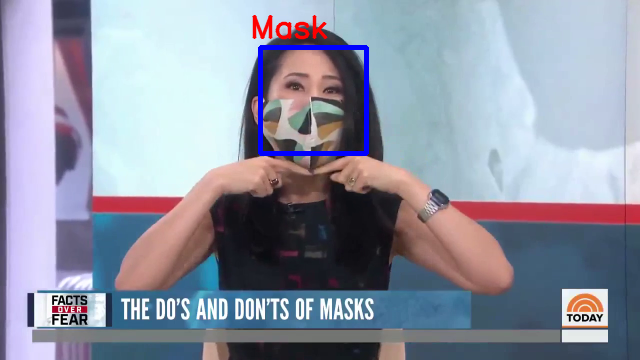

1/1 [==============================] - 0s 131ms/step


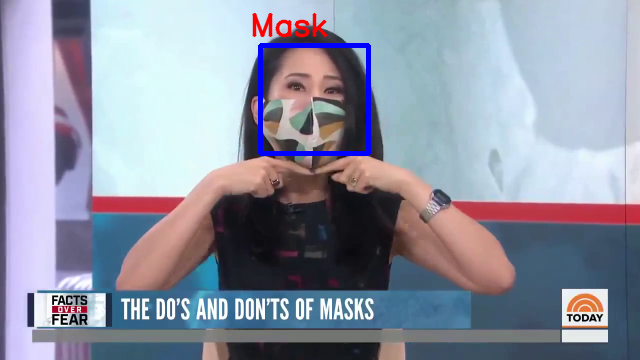

1/1 [==============================] - 0s 111ms/step


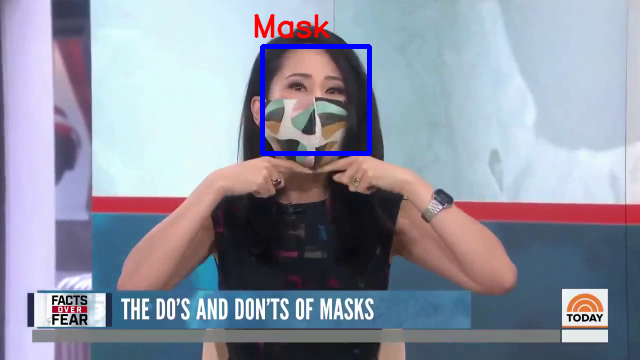

1/1 [==============================] - 0s 101ms/step


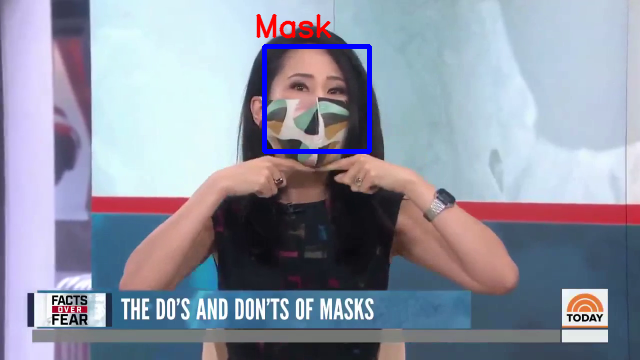

1/1 [==============================] - 0s 63ms/step


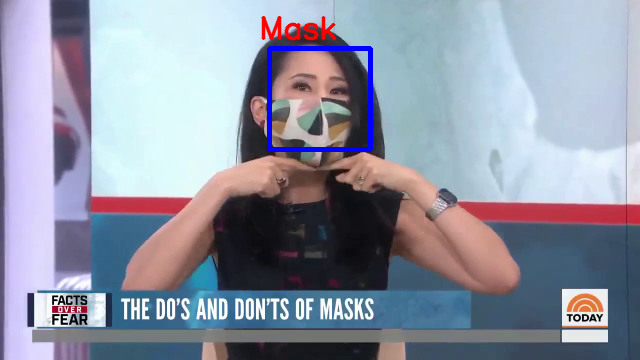

1/1 [==============================] - 0s 77ms/step


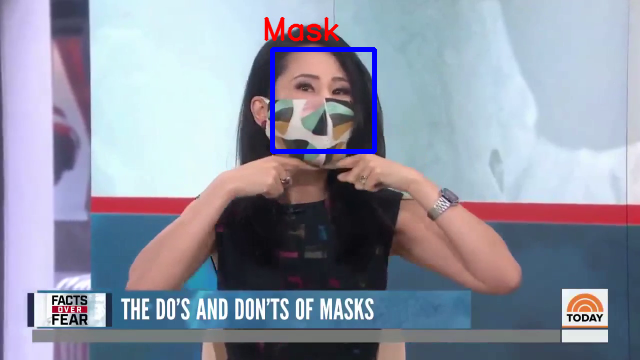

1/1 [==============================] - 0s 92ms/step


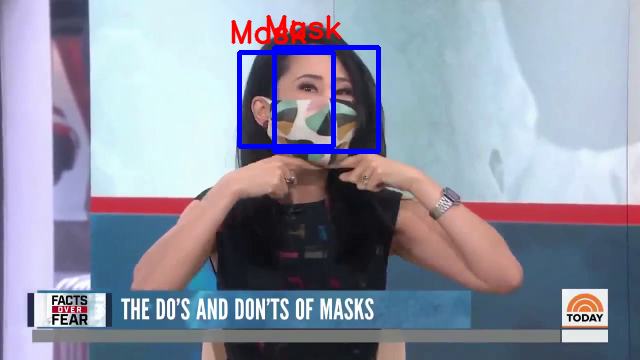

1/1 [==============================] - 0s 94ms/step


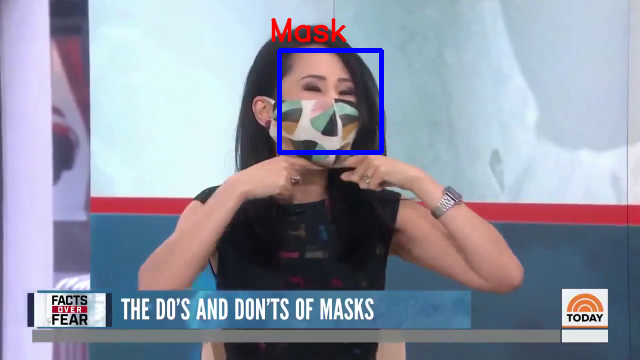

1/1 [==============================] - 0s 66ms/step


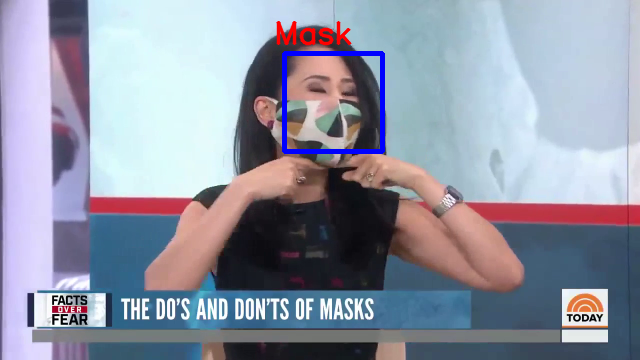

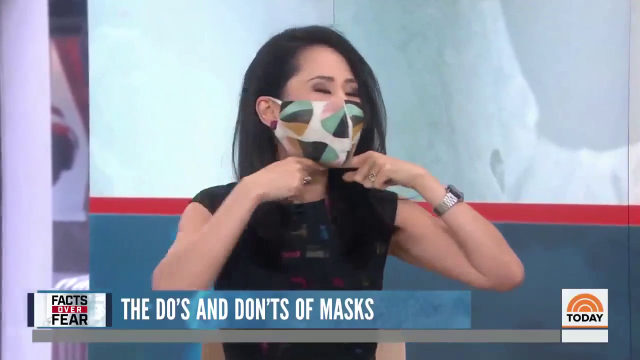

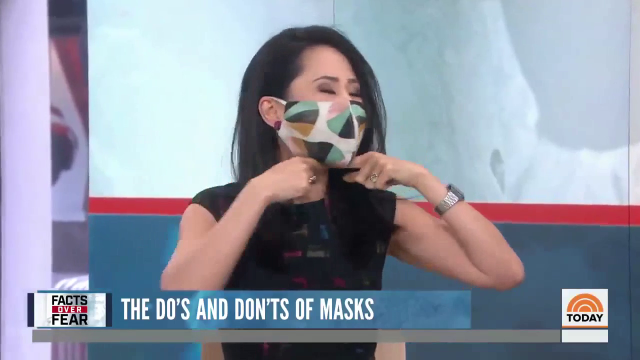

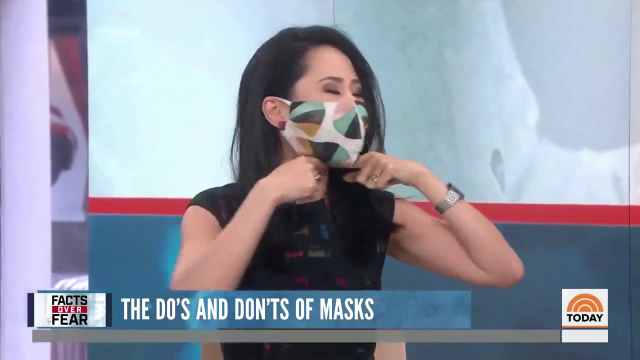

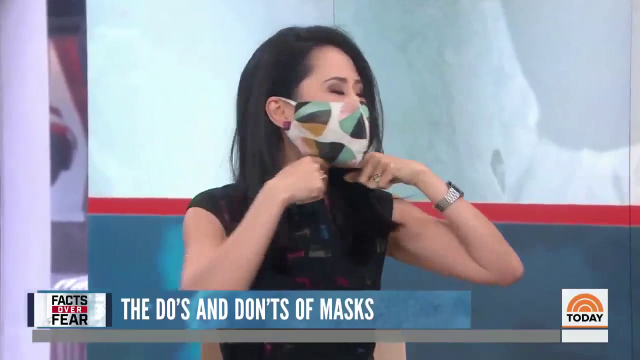

...

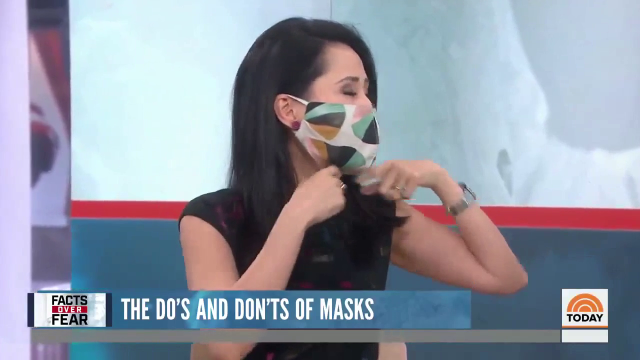

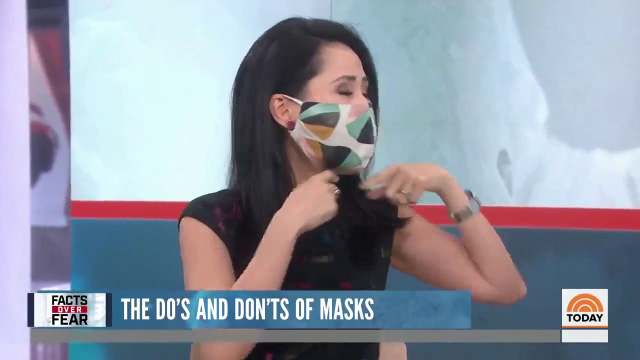

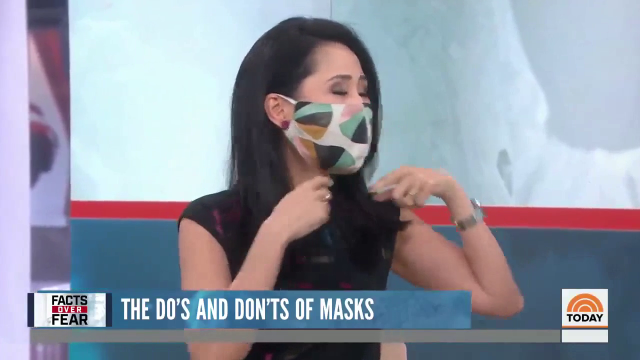

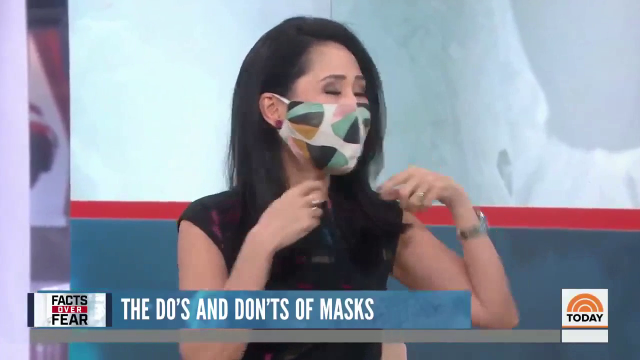

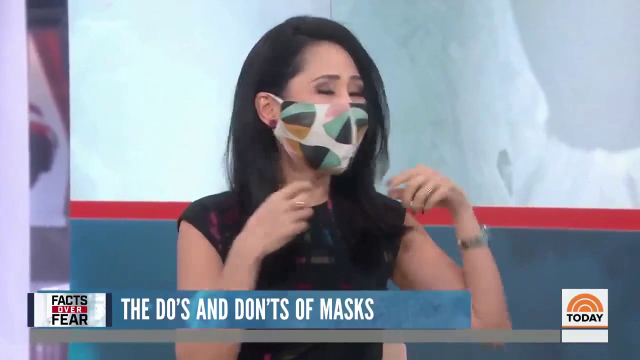

1/1 [==============================] - 0s 102ms/step


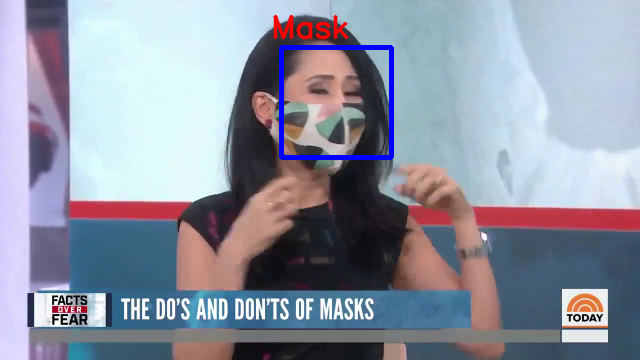

1/1 [==============================] - 0s 114ms/step


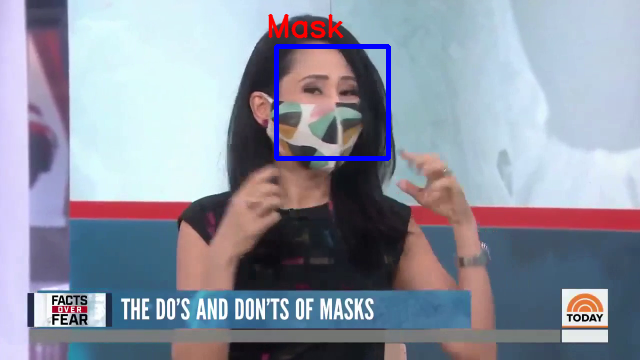

1/1 [==============================] - 0s 89ms/step


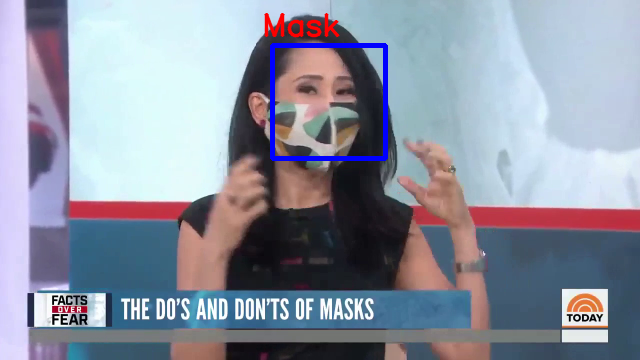

1/1 [==============================] - 0s 132ms/step


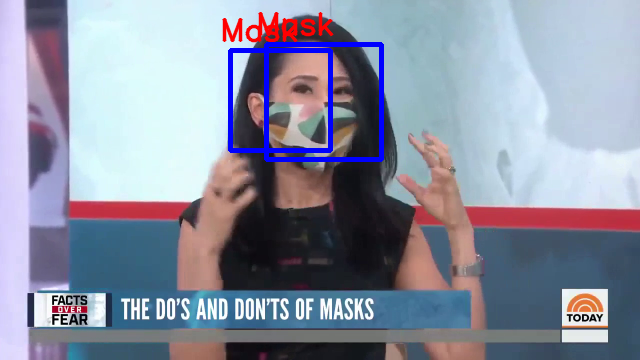

1/1 [==============================] - 0s 113ms/step


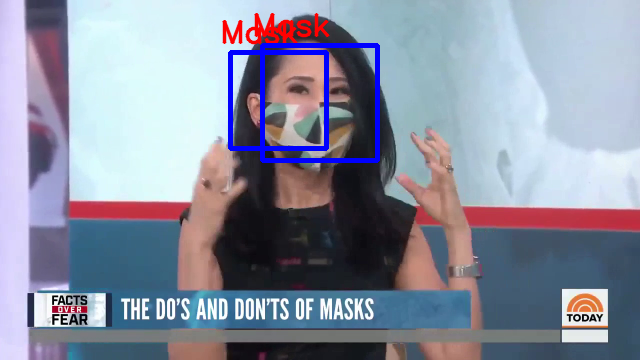

1/1 [==============================] - 0s 127ms/step


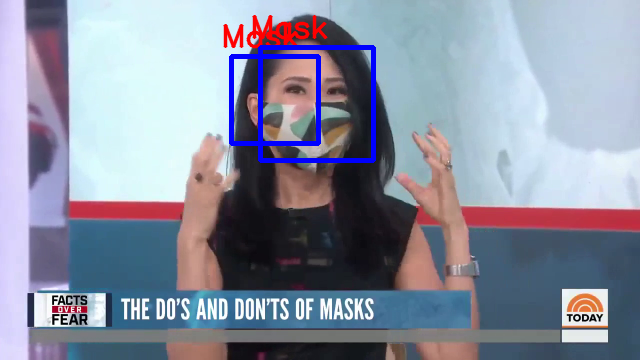

1/1 [==============================] - 0s 64ms/step


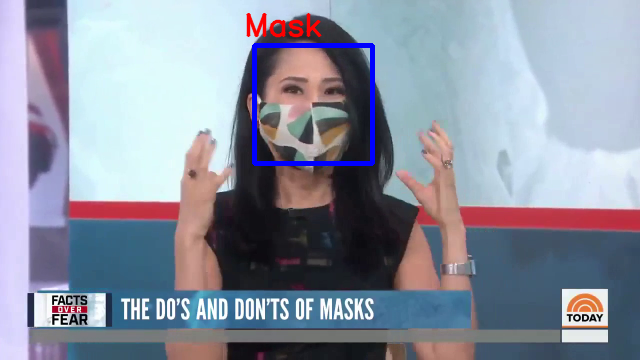

1/1 [==============================] - 0s 62ms/step


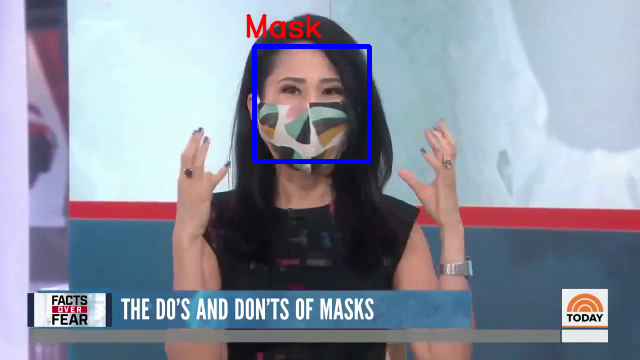

1/1 [==============================] - 0s 70ms/step


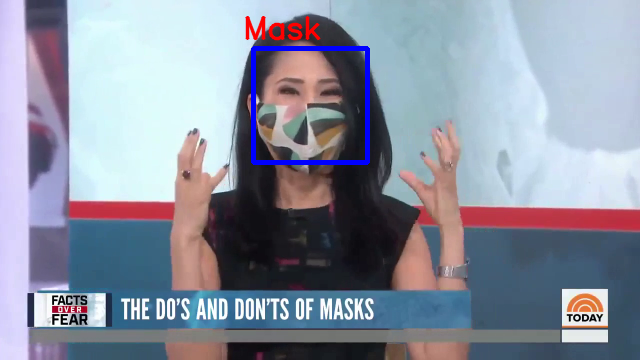

1/1 [==============================] - 0s 64ms/step


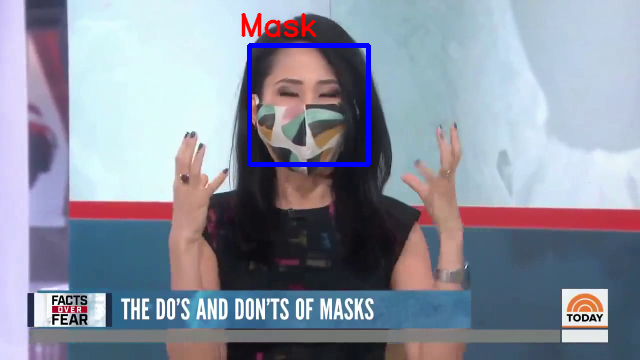

1/1 [==============================] - 0s 68ms/step


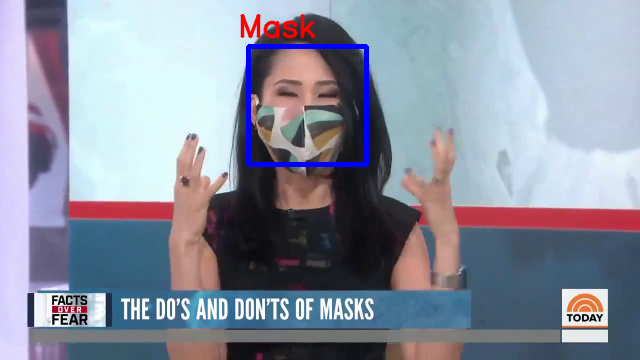

1/1 [==============================] - 0s 71ms/step


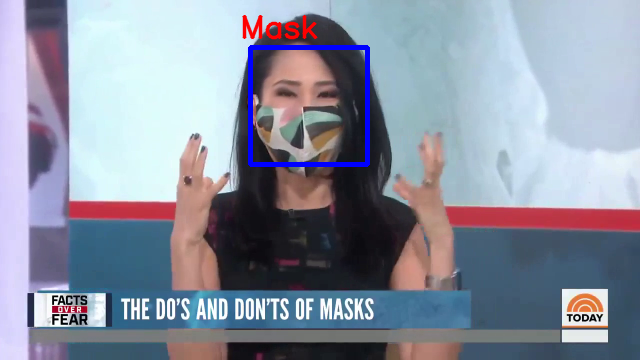

1/1 [==============================] - 0s 72ms/step


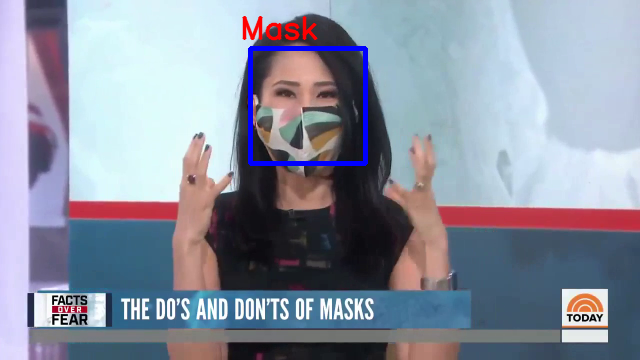

1/1 [==============================] - 0s 93ms/step


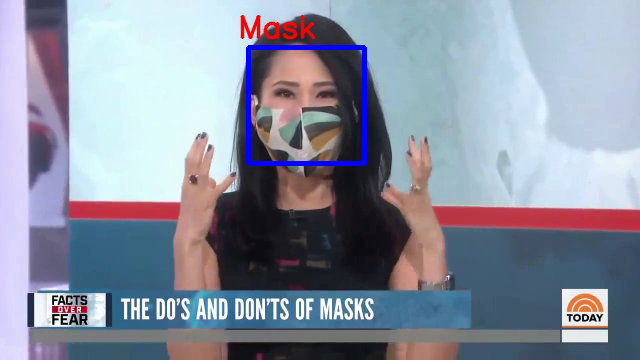

1/1 [==============================] - 0s 63ms/step


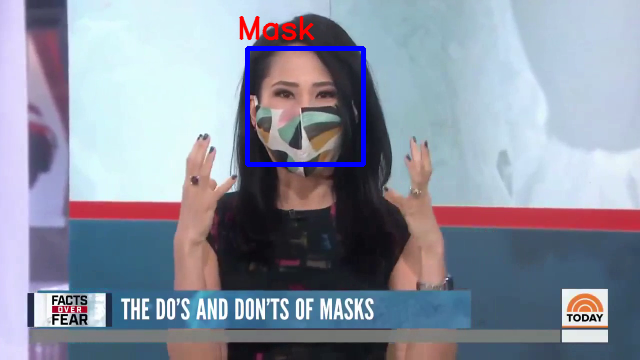

1/1 [==============================] - 0s 69ms/step


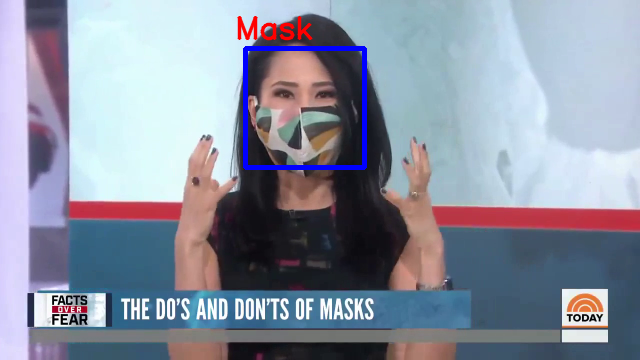

1/1 [==============================] - 0s 63ms/step


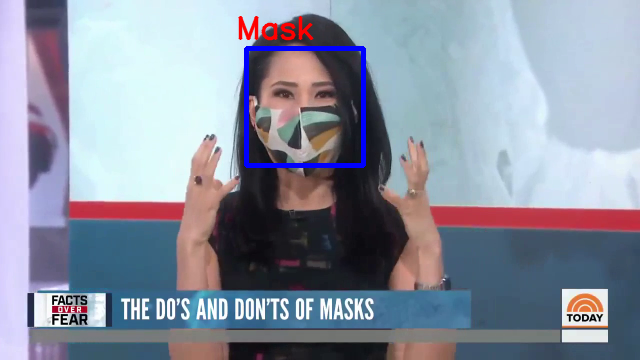

1/1 [==============================] - 0s 62ms/step


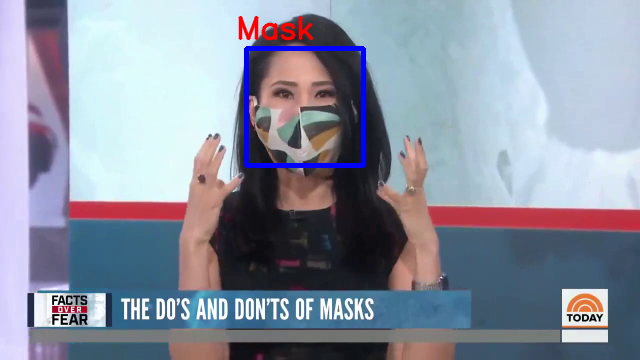

1/1 [==============================] - 0s 65ms/step


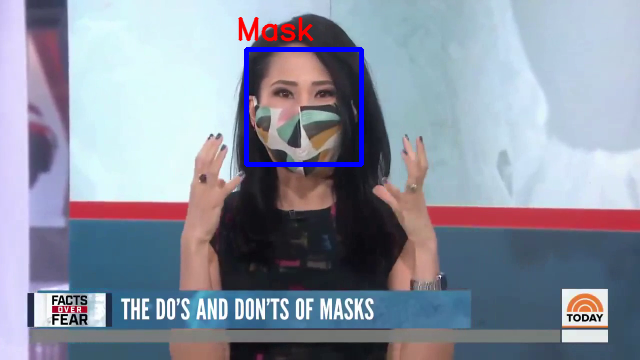

1/1 [==============================] - 0s 64ms/step


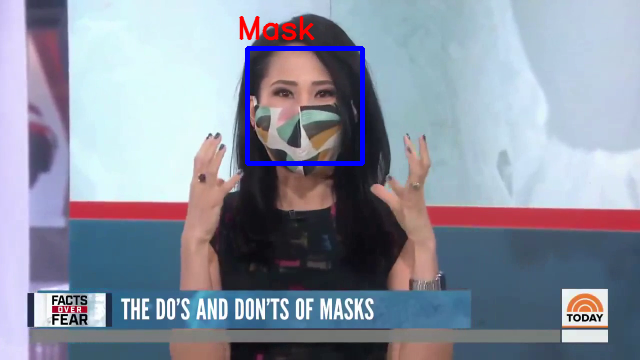

1/1 [==============================] - 0s 62ms/step


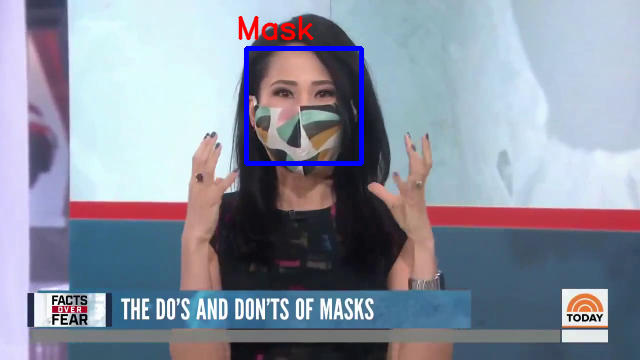

In [ ]:
import cv2
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import load_img , img_to_array
import numpy as np
from google.colab.patches import cv2_imshow

model = load_model('/content/drive/MyDrive/ai work/input/newsaved_model.h5')

img_width ,img_height =150,150

face_cascade = cv2.CascadeClassifier("/content/drive/MyDrive/ai work/haarcascade_frontalface_default.xml")

cap =cv2.VideoCapture("/content/drive/MyDrive/ai work/maskvideo.mp4")
cap.open("/content/drive/MyDrive/ai work/maskvideo.mp4")
print(cap.isOpened())
#cap =cv2.VideoCapture('0')
img_count_full =0
font =cv2.FONT_HERSHEY_SIMPLEX
org =(1,1)
class_label =''
fontScale =1
color =(255,0,0)
thickness =2
while True:
    img_count_full +=1
    response,color_img= cap.read()

    if response==False:
        break

    scale =50
    width  =int(color_img.shape[1]*scale/100)
    height =int(color_img.shape[0]*scale/100)
    dim=(width,height)

    color_img =cv2.resize(color_img,dim, interpolation =cv2.INTER_AREA)
    gray_img =cv2.cvtColor(color_img,cv2.COLOR_BGR2GRAY)
    faces=face_cascade.detectMultiScale(gray_img,1.1,6)
    img_count =0
    for(x,y,w,h) in faces:
        org=(x-10,y-10)
        img_count+=1
        color_face =color_img[y:y+h,x:x+w]
        cv2.imwrite('input%d%dface.jpg'%(img_count_full,img_count),color_face)
        img=load_img('input%d%dface.jpg'%(img_count_full,img_count),target_size =(img_width,img_height))
        img =img_to_array(img)
        img =np.expand_dims(img,axis =0)
        prediction =model.predict(img)
        if prediction==0:
            class_label ="Mask"
            color =(0,0,255)
        else:
            class_label ="No Mask"
            color =(0,0,255)
        cv2.rectangle(color_img,(x,y),(x+w,y+h),(255,0,0),3)
        cv2.putText(color_img,class_label,org,font,fontScale,color,thickness,cv2.LINE_AA)

    cv2_imshow(color_img)
    if cv2.waitKey(1) & 0xFF==ord('q'):
        break

cap.release()
cv2.destroyAllWindows()

